In [1]:
import pickle

with open('./coms_with_weather_dataset.pkl','rb') as f:
    data = pickle.load(f)
len(data)

25744

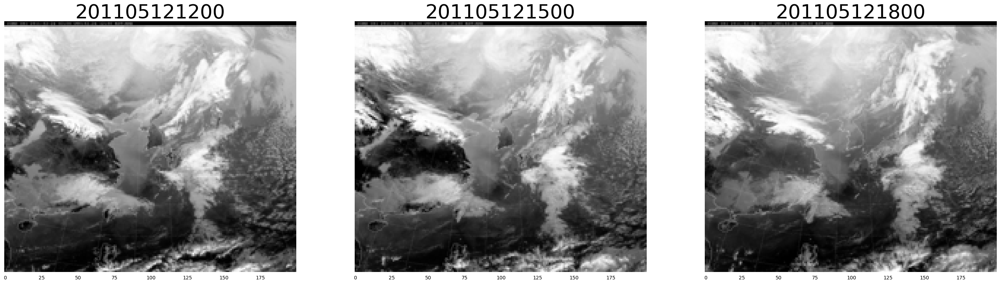

In [3]:
import matplotlib.pyplot as plt

plt.figure(figsize=(100,10))

for i in range(1, 4):
    plt.subplot(1, 8, i)
    plt.title(data[615 + i][0], fontsize = 40)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['bottom'].set_visible(False)

    plt.gca().tick_params(left=False, labelleft=False, bottom=False, labelbottom=True)
    name = f"{i}"
    
    name += 'th' if i != 1 and i != 2 else 'nd' if i == 2 else 'st'
    
#     plt.xlabel(f'{name} Data', fontsize=40)
    plt.imshow(data[i][1][0],cmap='gray')

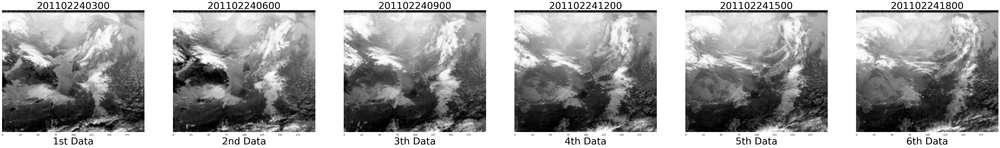

In [4]:
import matplotlib.pyplot as plt

plt.figure(figsize=(100,10))

for i in range(1, 7):
    plt.subplot(1, 8, i)
    plt.title(data[i][0], fontsize = 40)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['bottom'].set_visible(False)

    plt.gca().tick_params(left=False, labelleft=False, bottom=False, labelbottom=True)
    name = f"{i}"
    
    name += 'th' if i != 1 and i != 2 else 'nd' if i == 2 else 'st'
    
    plt.xlabel(f'{name} Data', fontsize=40)
    plt.imshow(data[i][1][0],cmap='gray')


In [5]:
region = ['춘천', '강릉', '서울', '인천', '울릉도', '청주', '대전', '포항'\
         '대구', '전주', '울산', '광주', '부산', '목포', '여수', '제주']

In [6]:
region = ['춘천', '강릉', '서울', '인천', '울릉도', '청주', '대전', '포항', '대구', '전주', '울산', '광주', '부산', '목포', '여수', '제주']
f_name = ['습도', '16방위풍향', '풍속', '현지기압', '해면기압', '이슬점 온도', '기온']

In [7]:
column = []
for f in f_name:
    for r in region:
        column.append(f'{r}_{f}')

In [8]:
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import RobustScaler

extra_data = [item[2] for item in data]
df = pd.DataFrame(extra_data, columns = column)

scaler = RobustScaler()
scaler.fit(df)

RobustScaler()

In [9]:
time_data = [[item[0][:8], item[0][8:]] for item in data]
time_df = pd.DataFrame(time_data, columns= ['날짜', '시간'])

In [10]:
df = pd.concat([time_df, df], axis=1)

In [8]:
df

,날짜,시간,춘천_습도,강릉_습도,서울_습도,인천_습도,울릉도_습도,청주_습도,대전_습도,포항_습도,...,대전_기온,포항_기온,대구_기온,전주_기온,울산_기온,광주_기온,부산_기온,목포_기온,여수_기온,제주_기온
0,20110224,0000,78.2,32.1,57.0,77.2,69.8,78.3,76.5,55.0,...,2.0,8.3,6.0,3.9,6.7,4.7,11.3,6.2,7.5,10.3
1,20110224,0300,49.0,19.9,49.2,58.9,56.7,53.7,43.6,40.7,...,12.2,14.8,14.7,13.3,17.5,12.3,16.5,12.0,12.9,13.5
2,20110224,0600,36.9,50.7,46.0,56.5,36.0,40.7,28.0,27.0,...,14.8,19.1,18.4,15.1,19.0,16.7,15.8,12.9,14.9,13.8
3,20110224,0900,51.6,33.0,58.9,73.5,53.6,47.9,45.7,29.0,...,12.5,18.0,17.4,10.5,15.4,11.5,13.9,8.8,11.8,12.9
4,20110224,1200,60.8,44.0,70.8,84.5,25.0,60.7,56.9,38.9,...,7.8,12.6,12.6,6.3,12.3,7.8,12.0,5.0,10.5,10.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25739,20200331,0900,21.0,55.6,26.0,30.1,83.8,21.0,27.1,60.6,...,18.6,14.3,19.3,15.3,12.9,16.6,14.0,11.4,14.2,14.4
25740,20200331,1200,35.9,69.6,27.1,48.1,90.9,29.9,30.1,72.5,...,12.9,12.2,13.7,9.7,10.9,12.3,12.0,8.5,12.6,14.0
25741,20200331,1500,44.0,70.6,38.1,60.8,94.7,31.9,28.0,84.4,...,11.1,9.7,11.8,9.5,9.7,10.9,11.9,8.3,12.2,12.7
25742,20200331,1800,58.9,37.0,36.0,32.1,86.6,43.0,35.9,72.6,...,9.9,10.5,10.8,8.7,9.6,9.4,11.1,8.2,11.6,10.9


In [11]:
def calculate_wind_chill(temp, wind_speed):
    return 13.12 + 0.6215 * temp - 11.37 * wind_speed**0.16 + 0.3965 * wind_speed**0.16 * temp

for r in region:
    df[f"{r}_체감온도"] = calculate_wind_chill(df[f'{r}_기온'], df[f"{r}_풍속"])
    
summer_label_df = df.groupby('날짜')[[f"{r}_체감온도" for r in region]].max()
winter_label_df = df.groupby('날짜')[[f"{r}_기온" for r in region]].min()

In [12]:
f_name = ['기온', '풍속']

In [11]:
print(len(df.columns))

130


In [ ]:
for f in f_name:
    col_name = []
    for r in region:
        col_name.append(f"{r}_{f}")
    
    not_col = [col for col in df.columns if col not in col_name]
    # A, B, C 열과 D, E 열을 별도의 DataFrame으로 분리
    df1 = df[not_col]
    df2 = df[col_name]
    
    print(len(df2.columns))
    print(len(df1.columns))

    # df1의 각 열과 df2의 각 열 간 상관관계 계산
    correlation_results = pd.DataFrame()

    for col1 in df1.columns:
        for col2 in df2.columns:
            corr_value = df1[col1].corr(df2[col2])
            correlation_results.loc[col1, col2] = corr_value
    
    # 시각화
    plt.figure(figsize=(100, 80))
    ax = sns.heatmap(correlation_results, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"fontsize": 40})
    plt.title(f"{f} Correlation Matrix Shift", fontsize = 100)
    
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)
    
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=100)
    
    plt.savefig(f"./corr/{f}.png")



In [13]:
time = ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100']

In [14]:
def average_images(image1, image2):
    # 두 이미지의 평균을 계산
    return (image1 + image2) // 2

In [15]:
from tqdm.auto import tqdm

In [16]:
check = dict()
for i in data:
    if i[0][:8] not in check:
        check[i[0][:8]] = []
    
    check[i[0][:8]].append(i[0][8:])

In [182]:
check

{'20110224': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110225': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110226': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110227': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110228': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110301': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110302': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110303': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110304': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110305': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110306': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110307': ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100'],
 '20110308': ['0000', '0300', '0600', '0900', '1200'

In [17]:
import numpy as np

In [18]:
time = ['0000', '0300', '0600', '0900', '1200', '1500', '1800', '2100']

In [19]:
new_data = []
key = list(check.keys())
key.sort()
key

data_idx = 0

for k in tqdm(key):
    if len(check[k]) == 8:
        for i in range(8):
            new_data.append(data[data_idx])
            data_idx += 1
    
    else:
        time_list = check[k]
        
        for time_idx in range(8):
            if time[time_idx] in time_list:
                new_data.append(data[data_idx])
                data_idx += 1
            
            else:
                tmp = []
                day = k
                
                tmp_img = average_images(np.array(data[data_idx][1]), np.array(data[data_idx-1][1]))

                tmp_feature = (np.array(data[data_idx][2]) + np.array(data[data_idx-1][2])) / 2

                tmp.append(day+time[time_idx])
                tmp.append(tmp_img)
                tmp.append(tmp_feature)
                new_data.append(tmp)

  0%|          | 0/3315 [00:00<?, ?it/s]

# 오토인코더 만들기~

In [20]:
winter = []
summer = []

for i in new_data:
    month = int(i[0][4:6])
    
    if month <= 4 or month >=10:
        winter.append(i)
    else:
        summer.append(i)

In [18]:
summer_group = {}
for time, img, feature_data in summer:
    date = time[:8]
    if date not in summer_group:
        summer_group[date] = {'img':[], 'num':[]}
    scaled_feature_data = scaler.transform([feature_data])
    
    summer_group[date]['img'].append(img)
    summer_group[date]['num'].append(scaled_feature_data.squeeze())
    
for date in summer_group:
    summer_group[date]['img'] = np.concatenate(summer_group[date]['img'], axis=0)
    summer_group[date]['num'] = np.concatenate(summer_group[date]['num'], axis=0)

C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fit

C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fit

In [19]:
s_key = list(summer_group.keys())
s_key.sort()

In [20]:
img_summer = np.array([summer_group[i]['img'] for i in s_key])
feature_summer = np.array([summer_group[i]['num'] for i in s_key])

In [21]:
summer_label = []

for idx, key in enumerate(s_key):
    if idx == len(s_key) -1:
        label = summer_label_df.loc['20191001']
    else:
        label = summer_label_df.loc[s_key[idx+1]]
    summer_label.append(np.array(label))

In [22]:
summer_data = [[s_key[i], img_summer[i], feature_summer[i], summer_label[i]] for i in range(len(s_key))]

In [26]:
s_key[-1]

'20190930'

In [27]:
before = 0
for idx, key in enumerate(s_key):
    if '2018' in key:
        print(idx)
        break

1071


In [21]:
import torch
import torch.nn as nn

IMG_HEIGHT = 172
IMG_WIDTH = 200
EMBEDDING_SIZE = 2048
FEATURE_SIZE = 112 * 8
OUT_DIM = len(region)

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

In [22]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CNNWithChannelAttention(nn.Module):
    def __init__(self, img_height, img_width, embedding_size, feature_size, out_dim, device):
        super(CNNWithChannelAttention, self).__init__()
        self.device = device
        self.encoder = nn.Sequential(
            nn.Conv2d(24, 48, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(48, 96, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(96, 192, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),

            nn.Flatten(),
            nn.Linear(192*(img_height >> 3)*(img_width >> 3), embedding_size)
        ).to(self.device)

        self.channel_attention = nn.Sequential(
            nn.Linear(EMBEDDING_SIZE, EMBEDDING_SIZE // 16, bias=False),
            nn.ReLU(inplace=True),
            nn.Linear(EMBEDDING_SIZE // 16, EMBEDDING_SIZE, bias=False),
            nn.Sigmoid()
        )  # 채널 수에 맞게 조정

        self.decoder = nn.Sequential(
            nn.ReLU(),
            nn.Linear(EMBEDDING_SIZE , 192*(IMG_HEIGHT >> 3)*(IMG_WIDTH >> 3)),
            nn.ReLU(),
            nn.Unflatten(1, (192, IMG_HEIGHT >> 3, IMG_WIDTH >> 3)),
            nn.Upsample((IMG_HEIGHT >> 2, IMG_WIDTH >> 2)),
            nn.Conv2d(192, 96, kernel_size=3, padding=1),
            nn.ReLU(),

            nn.Upsample((IMG_HEIGHT >> 1, IMG_WIDTH >> 1)),
            nn.Conv2d(96, 48, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Upsample((IMG_HEIGHT, IMG_WIDTH)),
            nn.Conv2d(48, 24, kernel_size=3, padding=1),
            nn.ReLU()
        ).to(self.device)
        
        self.linear = nn.Sequential(
            nn.Linear(EMBEDDING_SIZE + feature_size, EMBEDDING_SIZE),
            nn.ReLU(),
            nn.Linear(EMBEDDING_SIZE, 1024),
            nn.ReLU(),
            nn.Linear(1024, 512), 
            nn.ReLU(),
            nn.Linear(512, 128), 
            nn.ReLU(),
            nn.Linear(128, out_dim)
        )
        
        self.apply(self._init_weights)
        

    def forward(self, x, feature):
        embedding = self.encoder(x)
        
        combined = torch.cat((embedding, feature), dim=1)
        combined = self.linear(combined)
        
        x = self.channel_attention(embedding)
        x = self.decoder(x)
        
        return combined, x

    def _init_weights(self, m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.Linear):
            nn.init.kaiming_uniform_(m.weight, mode='fan_in', nonlinearity='relu')
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)

In [23]:
import numpy as np
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt

In [24]:
class ComsDataset(Dataset):
    def __init__(self, data):
        self.data = data
    
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, index):
        return self.data[index]

# # 2018년 데이터부터 테스트
# summer_train = summer_data[:1071]
# summer_test = summer_data[1071:]

In [50]:
coms_loader_train_summer = DataLoader(
    dataset=ComsDataset(summer_train),
    batch_size=16,
    shuffle=False,
)

In [51]:
coms_loader_test_summer = DataLoader(
    dataset=ComsDataset(summer_test),
    batch_size=16,
    shuffle=False
)

In [52]:
model_summer = CNNWithChannelAttention(IMG_HEIGHT, IMG_WIDTH, EMBEDDING_SIZE, FEATURE_SIZE ,OUT_DIM, DEVICE).to(DEVICE)

In [53]:
torch.cuda.empty_cache()

67it [00:06, 10.64it/s]


epoch: 0, step: 66, cost: 3908.48876953125


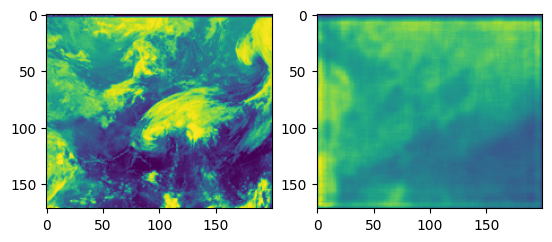

67it [00:06, 10.77it/s]


epoch: 1, step: 66, cost: 3913.417724609375


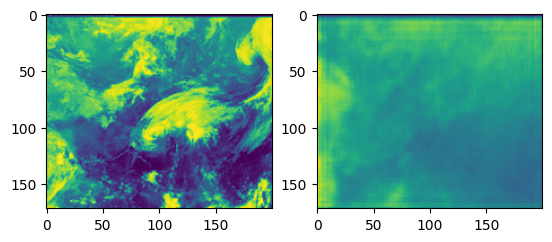

67it [00:06, 10.78it/s]


epoch: 2, step: 66, cost: 3891.728759765625


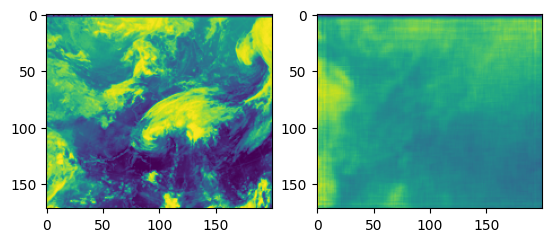

67it [00:06, 10.79it/s]


epoch: 3, step: 66, cost: 3844.39892578125


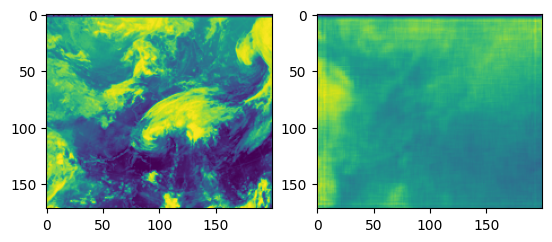

67it [00:06, 10.74it/s]


epoch: 4, step: 66, cost: 3811.911376953125


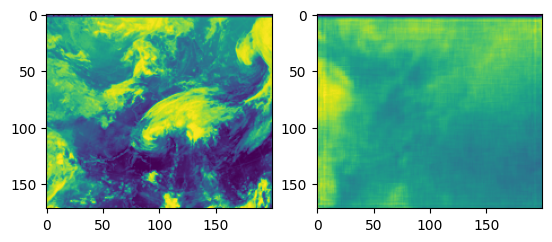

67it [00:06, 10.75it/s]


epoch: 5, step: 66, cost: 3780.162109375


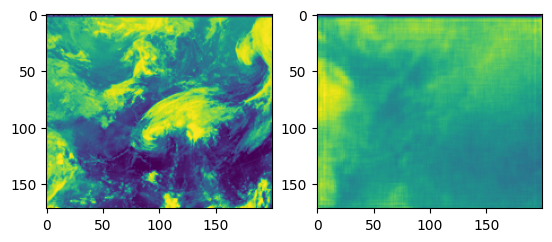

67it [00:06, 10.77it/s]


epoch: 6, step: 66, cost: 3757.2119140625


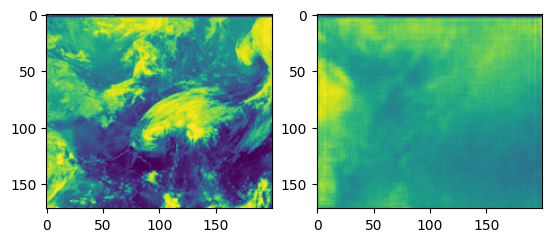

67it [00:06, 10.77it/s]


epoch: 7, step: 66, cost: 3735.95751953125


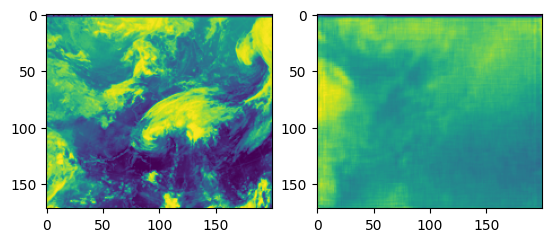

67it [00:06, 10.71it/s]


epoch: 8, step: 66, cost: 3723.611083984375


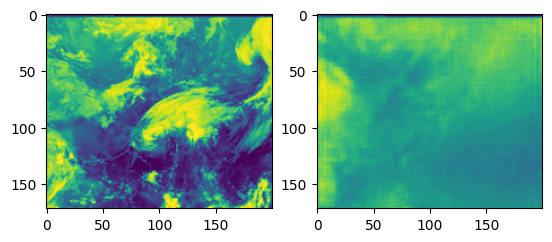

67it [00:06, 10.66it/s]


epoch: 9, step: 66, cost: 3713.579833984375


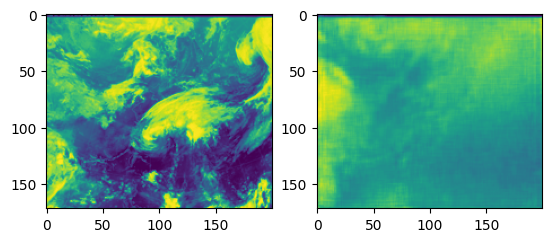

67it [00:06, 10.78it/s]


epoch: 10, step: 66, cost: 3694.990234375


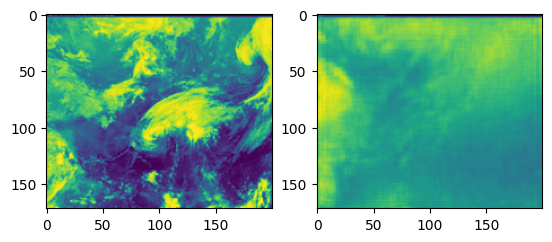

67it [00:06, 10.78it/s]


epoch: 11, step: 66, cost: 3676.201171875


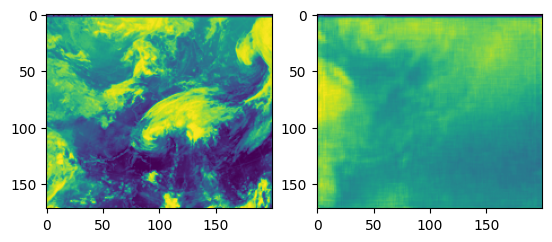

67it [00:06, 10.79it/s]


epoch: 12, step: 66, cost: 3660.02197265625


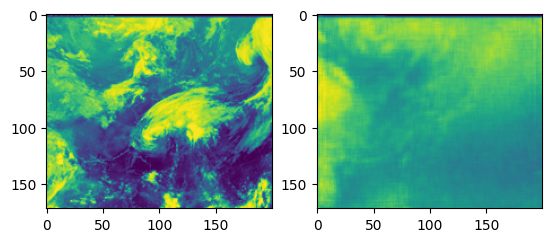

67it [00:06, 10.76it/s]


epoch: 13, step: 66, cost: 3647.13671875


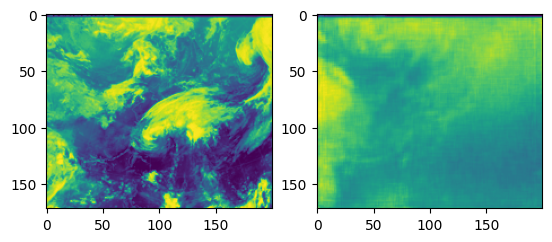

67it [00:06, 10.75it/s]


epoch: 14, step: 66, cost: 3635.738037109375


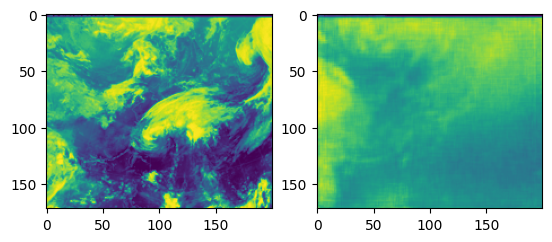

67it [00:06, 10.50it/s]


epoch: 15, step: 66, cost: 3628.252197265625


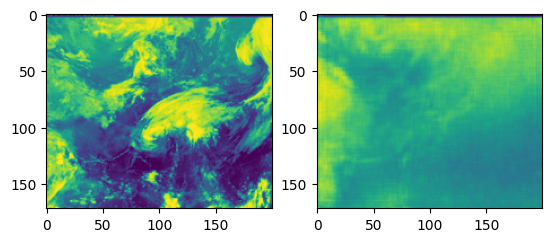

67it [00:06, 10.73it/s]


epoch: 16, step: 66, cost: 3620.28564453125


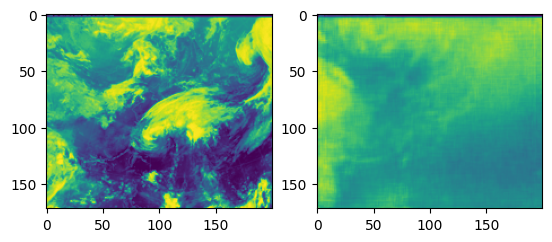

67it [00:06, 10.75it/s]


epoch: 17, step: 66, cost: 3613.855712890625


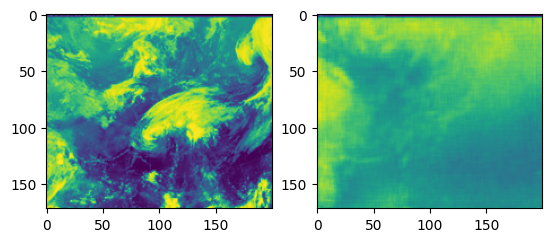

67it [00:06, 10.71it/s]


epoch: 18, step: 66, cost: 3605.414306640625


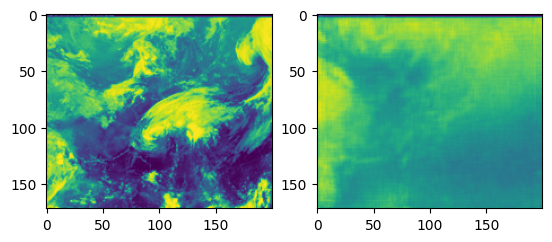

67it [00:06, 10.65it/s]


epoch: 19, step: 66, cost: 3594.703369140625


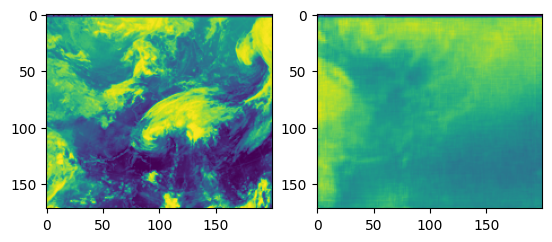

67it [00:06, 10.69it/s]


epoch: 20, step: 66, cost: 3588.5947265625


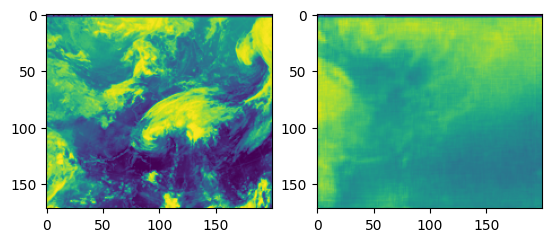

67it [00:06, 10.75it/s]


epoch: 21, step: 66, cost: 3583.78369140625


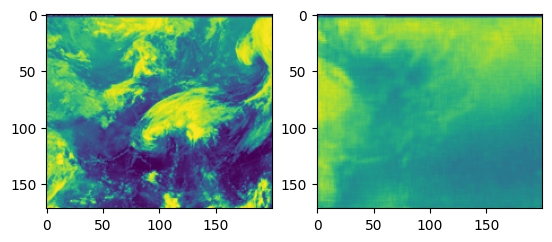

67it [00:06, 10.78it/s]


epoch: 22, step: 66, cost: 3577.335693359375


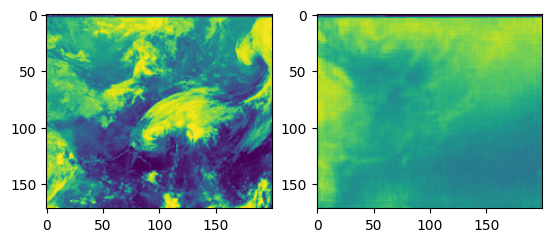

67it [00:06, 10.69it/s]


epoch: 23, step: 66, cost: 3570.2958984375


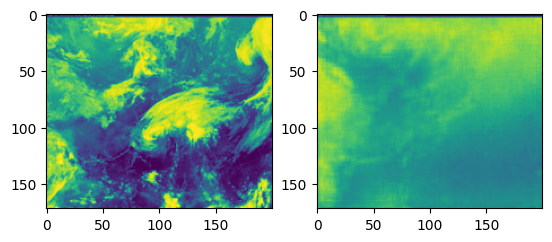

67it [00:06, 10.58it/s]


epoch: 24, step: 66, cost: 3563.188720703125


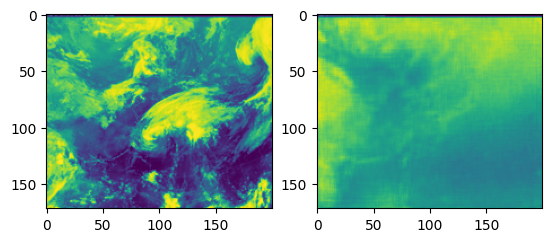

67it [00:06, 10.72it/s]


epoch: 25, step: 66, cost: 3557.834228515625


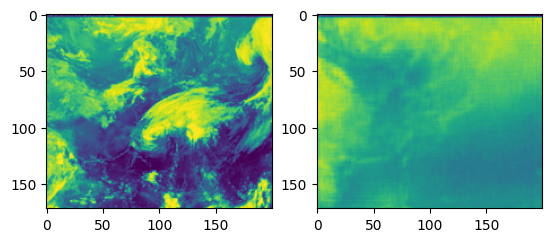

67it [00:06, 10.69it/s]


epoch: 26, step: 66, cost: 3555.062744140625


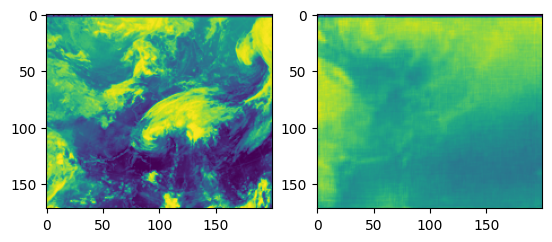

67it [00:06, 10.80it/s]


epoch: 27, step: 66, cost: 3546.4638671875


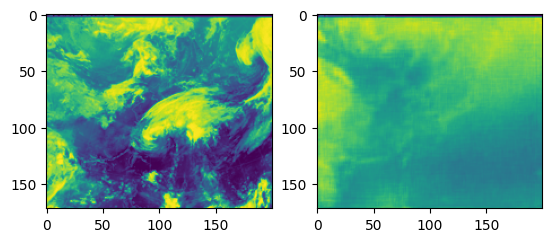

67it [00:06, 10.76it/s]


epoch: 28, step: 66, cost: 3543.684326171875


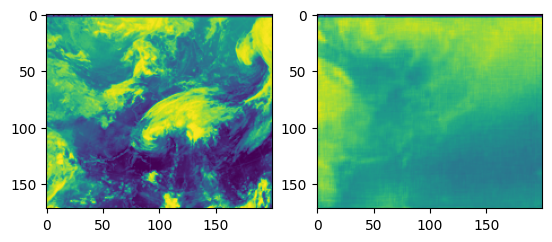

67it [00:06, 10.80it/s]


epoch: 29, step: 66, cost: 3539.9140625


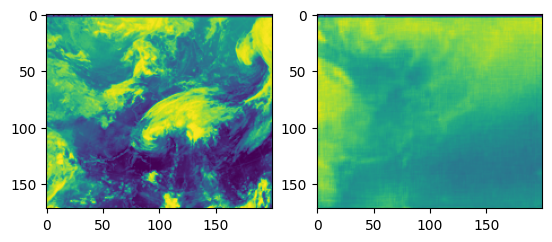

67it [00:06, 10.79it/s]


epoch: 30, step: 66, cost: 3536.403076171875


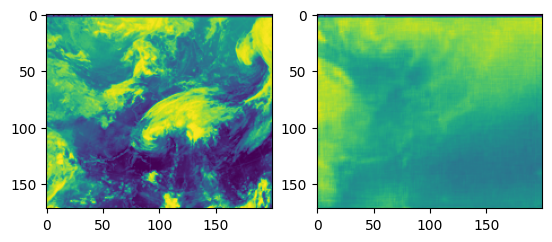

67it [00:06, 10.80it/s]


epoch: 31, step: 66, cost: 3535.2490234375


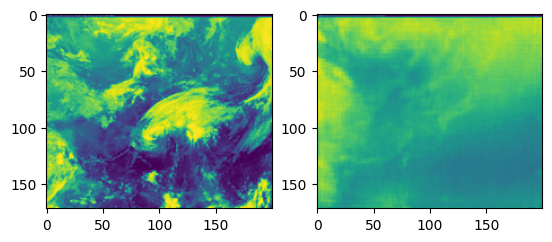

67it [00:06, 10.79it/s]


epoch: 32, step: 66, cost: 3532.22314453125


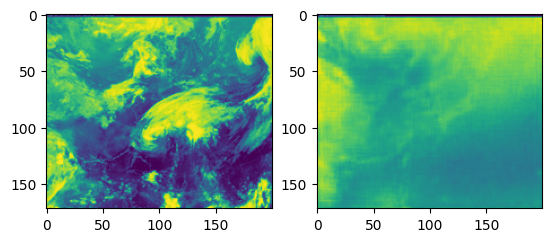

67it [00:06, 10.77it/s]


epoch: 33, step: 66, cost: 3531.01220703125


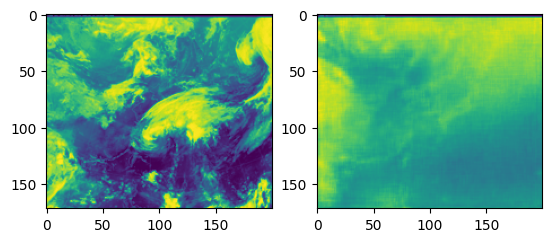

67it [00:06, 10.79it/s]


epoch: 34, step: 66, cost: 3529.419677734375


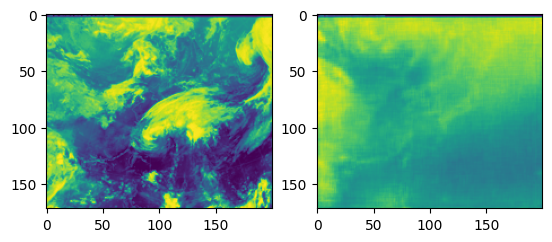

67it [00:06, 10.78it/s]


epoch: 35, step: 66, cost: 3529.8642578125


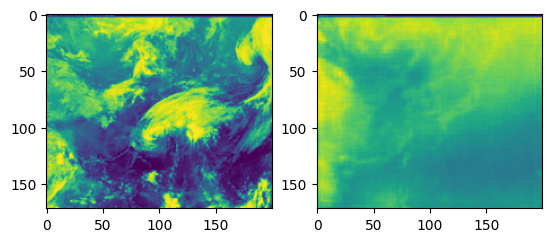

67it [00:06, 10.54it/s]


epoch: 36, step: 66, cost: 3525.2763671875


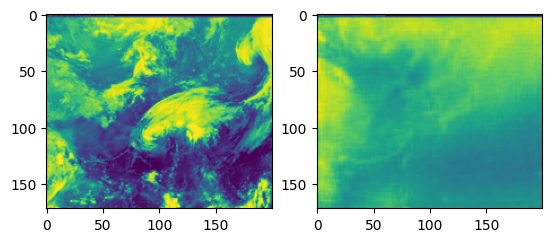

67it [00:06, 10.55it/s]


epoch: 37, step: 66, cost: 3524.275146484375


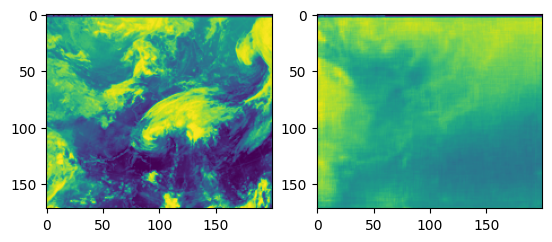

67it [00:06, 10.66it/s]


epoch: 38, step: 66, cost: 3518.647705078125


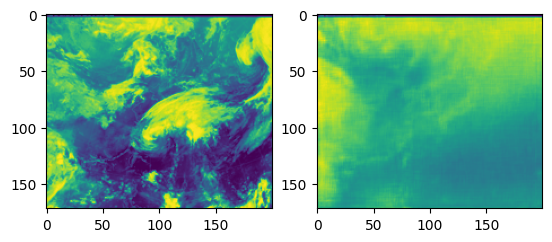

67it [00:06, 10.62it/s]


epoch: 39, step: 66, cost: 3524.29345703125


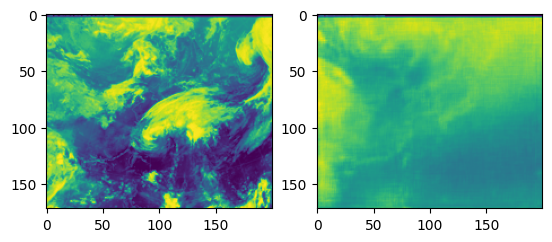

67it [00:06, 10.82it/s]


epoch: 40, step: 66, cost: 3526.9990234375


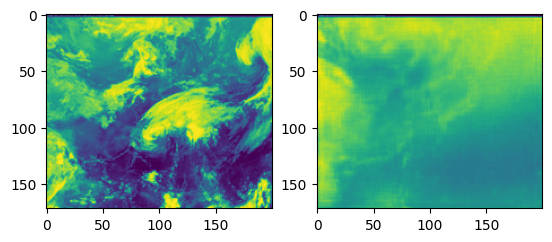

67it [00:06, 10.74it/s]


epoch: 41, step: 66, cost: 3533.25830078125


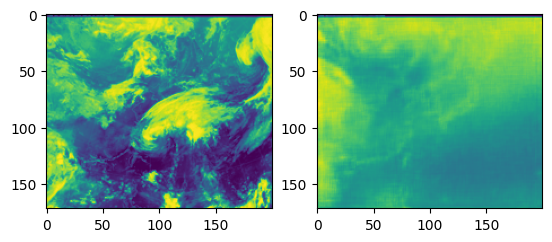

67it [00:06, 10.80it/s]


epoch: 42, step: 66, cost: 3545.128662109375


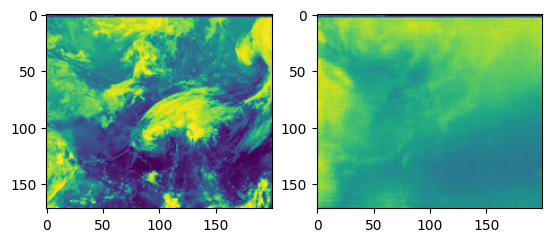

67it [00:06, 10.79it/s]


epoch: 43, step: 66, cost: 3537.95703125


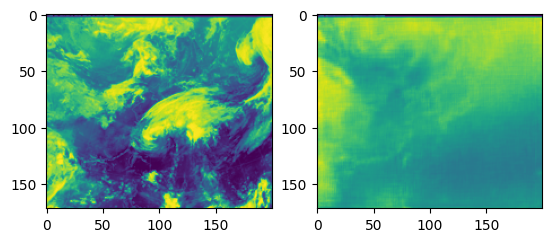

67it [00:06, 10.66it/s]


epoch: 44, step: 66, cost: 3538.791015625


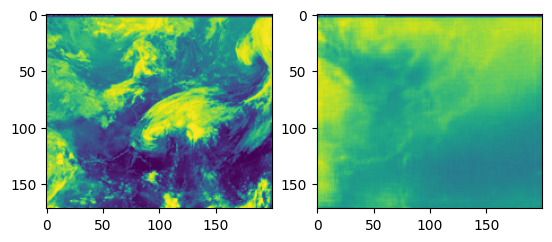

67it [00:06, 10.54it/s]


epoch: 45, step: 66, cost: 3539.466796875


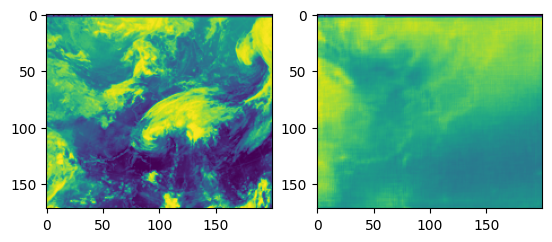

67it [00:06, 10.77it/s]


epoch: 46, step: 66, cost: 3522.252685546875


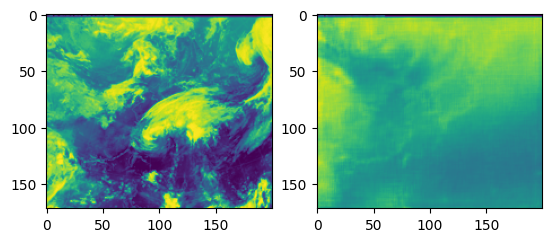

67it [00:06, 10.77it/s]


epoch: 47, step: 66, cost: 3528.644287109375


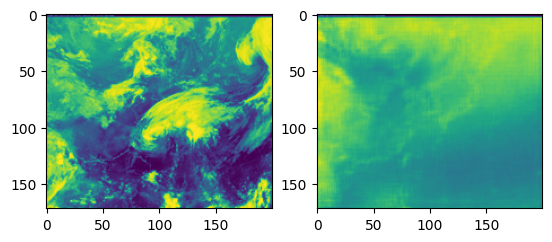

67it [00:06, 10.79it/s]


epoch: 48, step: 66, cost: 3544.952880859375


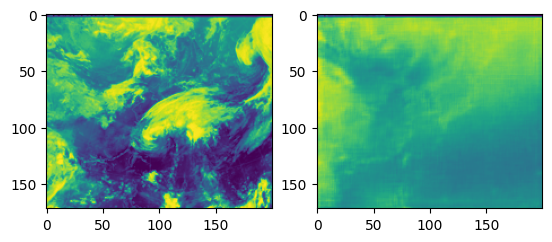

67it [00:06, 10.78it/s]


epoch: 49, step: 66, cost: 3542.886474609375


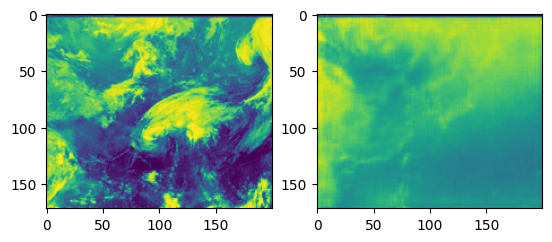

In [54]:
from tqdm import tqdm
from itertools import chain

loss_list = []
optim = torch.optim.Adam(model_summer.parameters(), lr=0.001)
mse = nn.MSELoss()

for epoch in range(50):
    for step, (date, img, feature, label) in tqdm(enumerate(coms_loader_train_summer)):
        
        x = img.to(DEVICE)
        feature = feature.to(torch.float32).to(DEVICE)
        reg, output = model_summer(x, feature)
        
        label = label.to(torch.float32).to(DEVICE)
        
        cost = mse(x, output)
        regression_loss = mse(reg, label)
        
        total_loss = cost + regression_loss
        
        optim.zero_grad()
        total_loss.backward()
        optim.step()
        loss_list.append(total_loss)
        
    with torch.no_grad():
        print(f"epoch: {epoch}, step: {step}, cost: {cost.item()}")
        plt.subplot(1, 2, 1)
        plt.imshow(x[0][0].cpu())
        plt.subplot(1, 2, 2)
        plt.imshow(output[0][0].cpu())
        plt.show()
        

In [55]:
len(loss_list)

3350

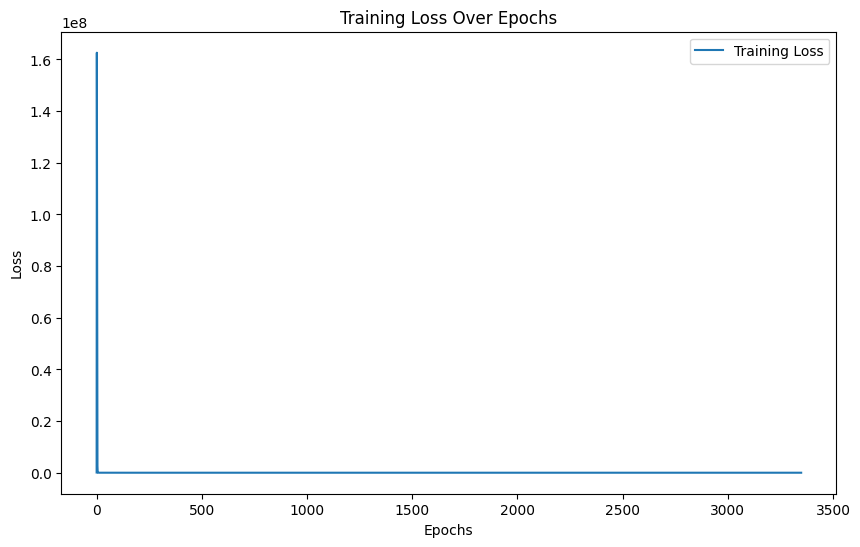

In [56]:
loss_array = [loss.cpu().detach().numpy() for loss in loss_list]

# 그래프 생성
plt.figure(figsize=(10, 6))
plt.plot(loss_array, label='Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Over Epochs')
plt.legend()
plt.show()

In [66]:
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score, recall_score

# 모델을 평가 모드로 설정
model_summer.eval()

# 예측과 레이블을 저장할 리스트 초기화
all_predictions = []
all_labels = []

# 테스트 데이터 로더를 통한 반복
with torch.no_grad():
    for step, (date, img, feature, label) in tqdm(enumerate(coms_loader_test_summer)):
        x = img.to(DEVICE)
        feature = feature.to(torch.float32).to(DEVICE)
        label = label.to(torch.float32).to(DEVICE)

        # 실제 레이블을 33을 기준으로 이진화
        binary_label = (label > 33).float()

        # 모델 예측
        reg, _ = model_summer(x, feature)

        # 임계값을 기준으로 예측 레이블 생성
        predicted = (reg > 33).float()

        # 예측과 레이블을 리스트에 추가
        all_predictions.extend(predicted.cpu().numpy())
        all_labels.extend(binary_label.cpu().numpy())

# 정밀도와 재현율 계산
precision = precision_score(all_labels, all_predictions, average='macro')
recall = recall_score(all_labels, all_predictions, average='macro')

print(f'Precision: {round(precision, 2)}')
print(f'Recall: {round(recall, 2)}')
f1_macro_score = f1_score(all_labels, all_predictions, average='macro')
print(f'F1 Macro Score: {round(f1_macro_score, 2)}')

19it [00:00, 34.30it/s]

Precision: 0.73
Recall: 0.74
F1 Macro Score: 0.72


In [80]:
from collections import Counter

# all_predictions와 all_labels 리스트를 numpy 배열로 변환
all_predictions_np = np.array(all_predictions)
all_labels_np = np.array(all_labels)

total = [{"TP" : 0, "TN" : 0, "FP" : 0, "FN" : 0} for i in range(len(all_labels[0]))]

for idx1, i in enumerate(all_labels):
    pred = all_predictions[idx1]
    for idx2, data in enumerate(i):
        if data == 1:
            if data == pred[idx2]:
                total[idx2]['TP'] += 1
            else:
                total[idx2]['FN'] += 1
        
        else:
            if data == pred[idx2]:
                total[idx2]['TN'] += 1
            else:
                total[idx2]['FP'] += 1


total
# # 레이블의 0과 1의 수 계산
# label_counts = Counter(all_labels_np)
# print("레이블의 0과 1의 수:", label_counts)

# # 예측의 0과 1의 수 계산
# prediction_counts = Counter(all_predictions_np)
# print("예측의 0과 1의 수:", prediction_counts)

[{'TP': 46, 'TN': 216, 'FP': 13, 'FN': 27},
 {'TP': 42, 'TN': 223, 'FP': 15, 'FN': 22},
 {'TP': 54, 'TN': 208, 'FP': 18, 'FN': 22},
 {'TP': 17, 'TN': 255, 'FP': 0, 'FN': 30},
 {'TP': 16, 'TN': 262, 'FP': 21, 'FN': 3},
 {'TP': 71, 'TN': 195, 'FP': 23, 'FN': 13},
 {'TP': 70, 'TN': 188, 'FP': 30, 'FN': 14},
 {'TP': 53, 'TN': 208, 'FP': 29, 'FN': 12},
 {'TP': 62, 'TN': 191, 'FP': 18, 'FN': 31},
 {'TP': 66, 'TN': 205, 'FP': 21, 'FN': 10},
 {'TP': 49, 'TN': 226, 'FP': 16, 'FN': 11},
 {'TP': 55, 'TN': 206, 'FP': 23, 'FN': 18},
 {'TP': 28, 'TN': 254, 'FP': 6, 'FN': 14},
 {'TP': 51, 'TN': 227, 'FP': 12, 'FN': 12},
 {'TP': 37, 'TN': 247, 'FP': 9, 'FN': 9},
 {'TP': 41, 'TN': 213, 'FP': 39, 'FN': 9}]

In [109]:
sea = ['울릉도', '제주', '춘천', '강릉', '인천', '부산', '여수', '목포', '포항']


In [51]:
def calculate_f1_score(TP, FN, FP, TN):
    # 정밀도(Precision) 계산
    precision = TP / (TP + FP) if (TP + FP) != 0 else 0

    # 재현율(Recall) 계산
    recall = TP / (TP + FN) if (TP + FN) != 0 else 0

    # F1 점수 계산
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) != 0 else 0

    return round(f1_score, 2)

In [120]:
print("지역     TP      FP      FN       TN      F1")
for i in range(len(region)):
    print(region[i], "\t",total[i]['TP'], "\t", total[i]['FP'], "\t", total[i]['FN'], "\t", total[i]['TN'], "\t", calculate_f1_score(total[i]['TP'], total[i]['FN'], total[i]['FP'], total[i]['TN']))

지역     TP      FP      FN       TN      F1
춘천 	 46 	 13 	 27 	 216 	 0.7
강릉 	 42 	 15 	 22 	 223 	 0.69
서울 	 54 	 18 	 22 	 208 	 0.73
인천 	 17 	 0 	 30 	 255 	 0.53
울릉도 	 16 	 21 	 3 	 262 	 0.57
청주 	 71 	 23 	 13 	 195 	 0.8
대전 	 70 	 30 	 14 	 188 	 0.76
포항 	 53 	 29 	 12 	 208 	 0.72
대구 	 62 	 18 	 31 	 191 	 0.72
전주 	 66 	 21 	 10 	 205 	 0.81
울산 	 49 	 16 	 11 	 226 	 0.78
광주 	 55 	 23 	 18 	 206 	 0.73
부산 	 28 	 6 	 14 	 254 	 0.74
목포 	 51 	 12 	 12 	 227 	 0.81
여수 	 37 	 9 	 9 	 247 	 0.8
제주 	 41 	 39 	 9 	 213 	 0.63


In [119]:
print("지역     TP      FP      FN       TN      F1")
for i in range(len(region)):
    if region[i] not in sea:
        print(region[i], "\t",total[i]['TP'], "\t", total[i]['FP'], "\t", total[i]['FN'], "\t", total[i]['TN'], "\t", calculate_f1_score(total[i]['TP'], total[i]['FN'], total[i]['FP'], total[i]['TN']))

지역     TP      FP      FN       TN      F1
서울 	 54 	 18 	 22 	 208 	 0.73
청주 	 71 	 23 	 13 	 195 	 0.8
대전 	 70 	 30 	 14 	 188 	 0.76
대구 	 62 	 18 	 31 	 191 	 0.72
전주 	 66 	 21 	 10 	 205 	 0.81
울산 	 49 	 16 	 11 	 226 	 0.78
광주 	 55 	 23 	 18 	 206 	 0.73


In [104]:
pred = [[0,0] for i in range(len(all_labels[0]))]

for i in all_predictions:
    
    for idx, data in enumerate(i):
        pred[idx][0] += data
        pred[idx][1] += 1

pred

[[59.0, 302],
 [57.0, 302],
 [72.0, 302],
 [17.0, 302],
 [37.0, 302],
 [94.0, 302],
 [100.0, 302],
 [82.0, 302],
 [80.0, 302],
 [87.0, 302],
 [65.0, 302],
 [78.0, 302],
 [34.0, 302],
 [63.0, 302],
 [46.0, 302],
 [80.0, 302]]

# 여기서부터는 겨울

In [25]:
winter_group = {}
for time, img, feature_data in winter:
    date = time[:8]
    if date not in winter_group:
        winter_group[date] = {'img':[], 'num':[]}
    scaled_feature_data = scaler.transform([feature_data])
    
    winter_group[date]['img'].append(img)
    winter_group[date]['num'].append(scaled_feature_data.squeeze())
    
for date in winter_group:
    winter_group[date]['img'] = np.concatenate(winter_group[date]['img'], axis=0)
    winter_group[date]['num'] = np.concatenate(winter_group[date]['num'], axis=0)

C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fit

C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fit

C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fitted with feature names
  warnings.warn(
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RobustScaler was fit

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [26]:
w_key = list(winter_group.keys())
w_key.sort()

In [27]:
img_winter = np.array([winter_group[i]['img'] for i in w_key])
feature_winter = np.array([winter_group[i]['num'] for i in w_key])

In [94]:
before = 0
for idx, key in enumerate(w_key):
    if '2018' in key:
        print(idx)
        break

1431


In [95]:
w_key[-1]

'20200331'

In [28]:
winter_label_today = []
winter_label_next = []
winter_label_two= []

for idx, key in enumerate(w_key):
    if idx == len(w_key) -1:
        continue
    
    elif idx == len(w_key) -2:
        continue
    
    elif idx == len(w_key) -3:
        continue
        
    else:
        label_today = winter_label_df.loc[w_key[idx]]
        label_next = winter_label_df.loc[w_key[idx+1]]
        label_two = winter_label_df.loc[w_key[idx+2]]
        
        
    winter_label_today.append(np.array(label_today))
    winter_label_next.append(np.array(label_next))
    winter_label_two.append(np.array(label_two))

In [29]:
winter_data = [[w_key[i], img_winter[i], feature_winter[i], winter_label_today[i], winter_label_next[i], winter_label_two[i]] for i in range(len(w_key)-3)]

In [30]:
winter_train = winter_data[:1431]
winter_test = winter_data[1431:]

In [31]:
coms_loader_train_winter = DataLoader(
    dataset=ComsDataset(winter_train),
    batch_size=16,
    shuffle=False
)

In [32]:
coms_loader_test_winter = DataLoader(
    dataset=ComsDataset(winter_test),
    batch_size=16,
    shuffle=False
)

In [69]:
class CNNWithChannelAttention(nn.Module):
    def __init__(self, img_height, img_width, embedding_size, feature_size, out_dim, device):
        super(CNNWithChannelAttention, self).__init__()
        self.device = device
        self.encoder = nn.Sequential(
            nn.Conv2d(24, 36, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(36, 72, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(72, 144, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),

            nn.Flatten(),
            nn.Linear(144*(img_height >> 3)*(img_width >> 3), embedding_size)
        ).to(self.device)

        self.channel_attention = nn.Sequential(
            nn.Linear(EMBEDDING_SIZE, EMBEDDING_SIZE // 16, bias=False),
            nn.ReLU(inplace=True),
            nn.Linear(EMBEDDING_SIZE // 16, EMBEDDING_SIZE, bias=False),
            nn.Sigmoid()
        )  # 채널 수에 맞게 조정

        self.decoder = nn.Sequential(
            nn.ReLU(),
            nn.Linear(EMBEDDING_SIZE , 144*(IMG_HEIGHT >> 3)*(IMG_WIDTH >> 3)),
            nn.ReLU(),
            nn.Unflatten(1, (144, IMG_HEIGHT >> 3, IMG_WIDTH >> 3)),
            nn.Upsample((IMG_HEIGHT >> 2, IMG_WIDTH >> 2)),
            nn.Conv2d(144, 72, kernel_size=3, padding=1),
            nn.ReLU(),

            nn.Upsample((IMG_HEIGHT >> 1, IMG_WIDTH >> 1)),
            nn.Conv2d(72, 36, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Upsample((IMG_HEIGHT, IMG_WIDTH)),
            nn.Conv2d(36, 24, kernel_size=3, padding=1),
            nn.ReLU()
        ).to(self.device)
        
        self.linear = nn.Sequential(
            nn.Linear(EMBEDDING_SIZE + feature_size, EMBEDDING_SIZE),
            nn.ReLU(),
            nn.Linear(EMBEDDING_SIZE, 1024),
            nn.ReLU(),
            nn.Linear(1024, 512), 
            nn.ReLU(),
            nn.Linear(512, 128), 
            nn.ReLU(),
            nn.Linear(128, out_dim)
        )
        
        self.nextday = nn.Sequential(
            nn.Linear(EMBEDDING_SIZE + feature_size + out_dim, EMBEDDING_SIZE),
            nn.ReLU(),
            nn.Linear(EMBEDDING_SIZE, 1024),
            nn.ReLU(),
            nn.Linear(1024, 512), 
            nn.ReLU(),
            nn.Linear(512, 128), 
            nn.ReLU(),
            nn.Linear(128, out_dim)
        )
        self.apply(self._init_weights)

    def forward(self, x, feature):
        embedding = self.encoder(x)
        
        combined = torch.cat((embedding, feature), dim=1)
        today = self.linear(combined)
        c = torch.cat((combined, today), dim=1)
        next_day = self.nextday(c)
        
        x = self.channel_attention(embedding)
        x = self.decoder(x)
        
        return today, next_day, x
    
    def _init_weights(self, m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.Linear):
            nn.init.kaiming_uniform_(m.weight, mode='fan_in', nonlinearity='relu')
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)

In [70]:
model_winter = CNNWithChannelAttention(IMG_HEIGHT, IMG_WIDTH, EMBEDDING_SIZE, FEATURE_SIZE ,OUT_DIM, DEVICE).to(DEVICE)

90it [00:06, 13.17it/s]


epoch: 0, step: 89, cost: 1624.967529296875


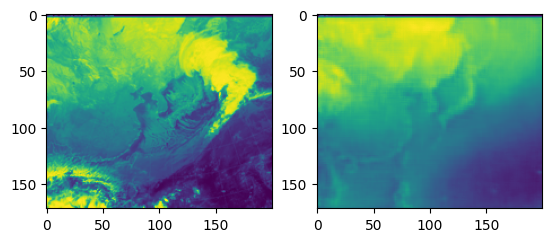

90it [00:06, 13.31it/s]


epoch: 1, step: 89, cost: 1550.0601806640625


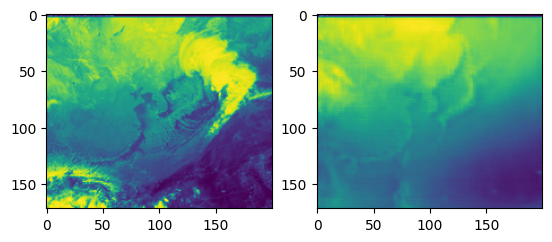

90it [00:06, 13.23it/s]


epoch: 2, step: 89, cost: 1540.4798583984375


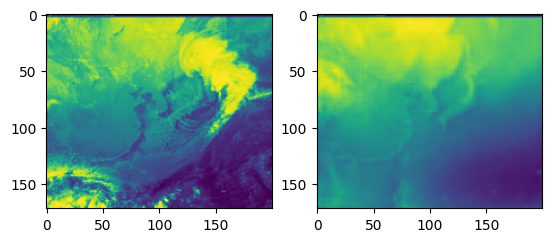

90it [00:06, 13.17it/s]


epoch: 3, step: 89, cost: 1518.0262451171875


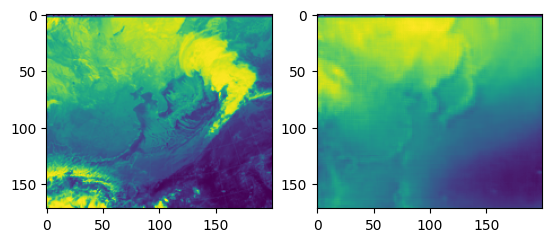

90it [00:06, 13.17it/s]


epoch: 4, step: 89, cost: 1499.954833984375


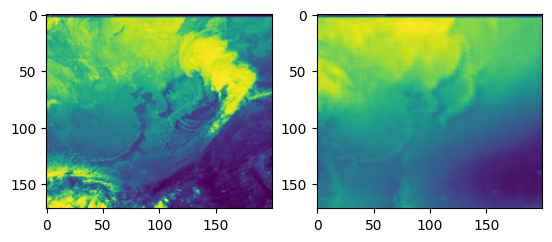

90it [00:06, 13.18it/s]


epoch: 5, step: 89, cost: 1640.2640380859375


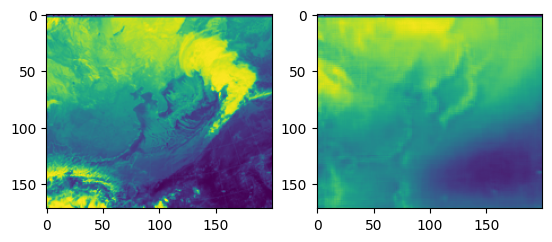

90it [00:06, 13.21it/s]


epoch: 6, step: 89, cost: 1525.9949951171875


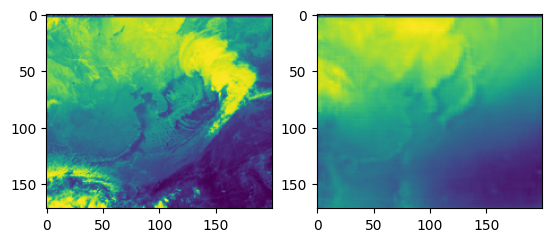

90it [00:06, 13.19it/s]


epoch: 7, step: 89, cost: 1505.162353515625


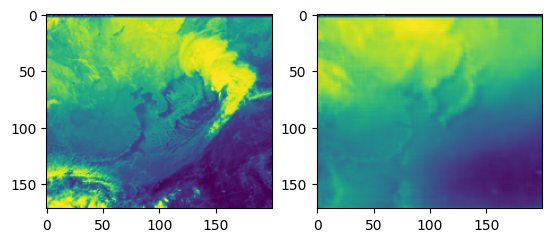

90it [00:06, 13.19it/s]


epoch: 8, step: 89, cost: 1641.5584716796875


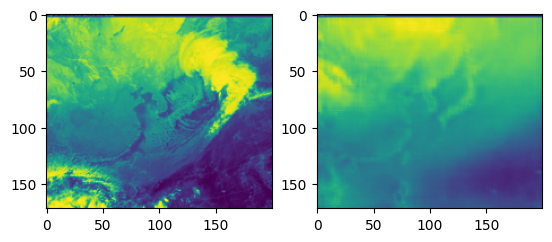

90it [00:06, 13.18it/s]


epoch: 9, step: 89, cost: 1573.24853515625


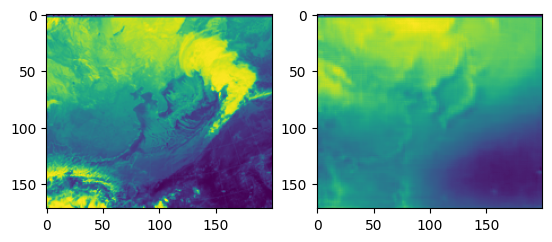

90it [00:06, 13.27it/s]


epoch: 10, step: 89, cost: 1553.097900390625


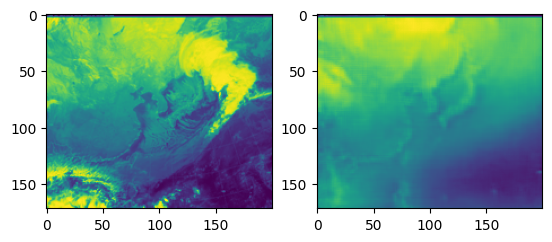

90it [00:06, 13.34it/s]


epoch: 11, step: 89, cost: 1509.0640869140625


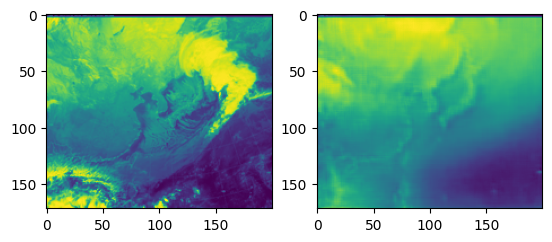

90it [00:06, 13.17it/s]


epoch: 12, step: 89, cost: 1503.8953857421875


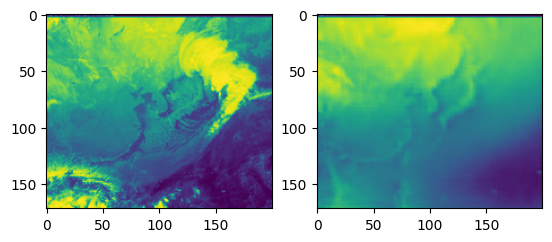

90it [00:06, 13.21it/s]


epoch: 13, step: 89, cost: 1483.6363525390625


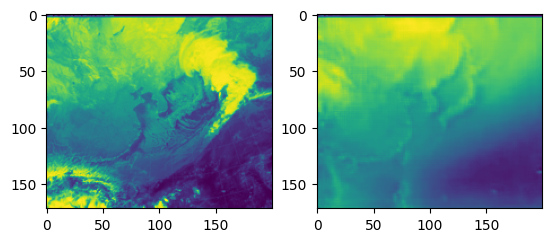

90it [00:06, 12.94it/s]


epoch: 14, step: 89, cost: 1532.5916748046875


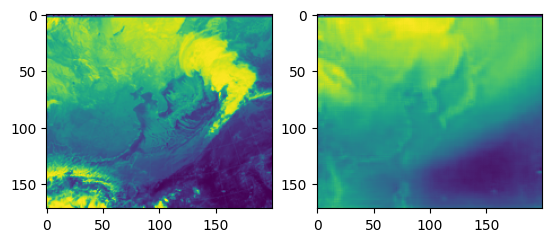

90it [00:06, 13.27it/s]


epoch: 15, step: 89, cost: 1467.6776123046875


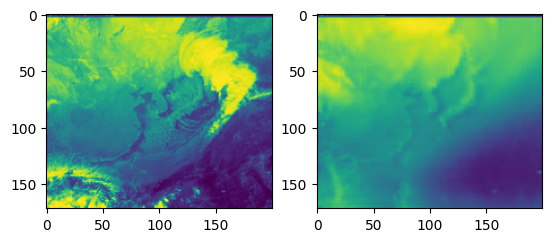

90it [00:06, 13.21it/s]


epoch: 16, step: 89, cost: 1517.29052734375


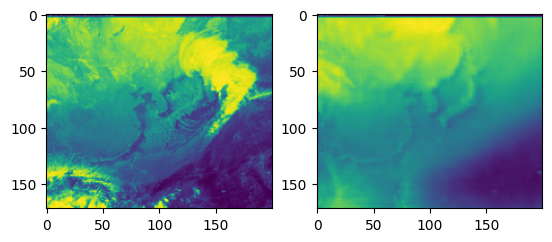

90it [00:06, 13.13it/s]


epoch: 17, step: 89, cost: 1460.8416748046875


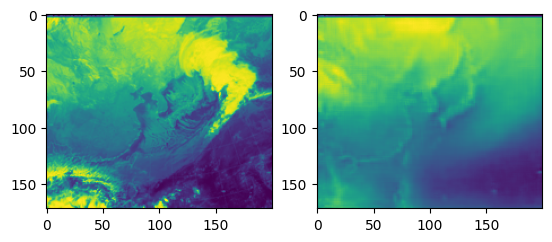

90it [00:06, 12.99it/s]


epoch: 18, step: 89, cost: 1491.2244873046875


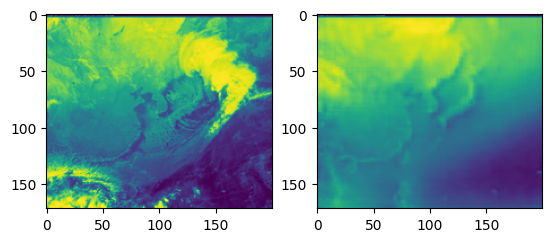

90it [00:06, 13.20it/s]


epoch: 19, step: 89, cost: 1487.255859375


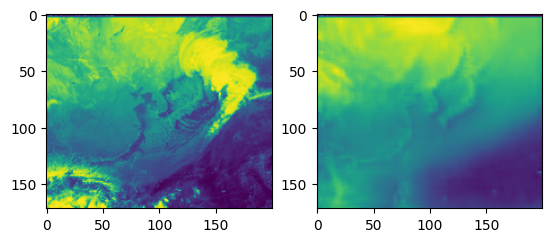

90it [00:06, 13.20it/s]


epoch: 20, step: 89, cost: 1417.4434814453125


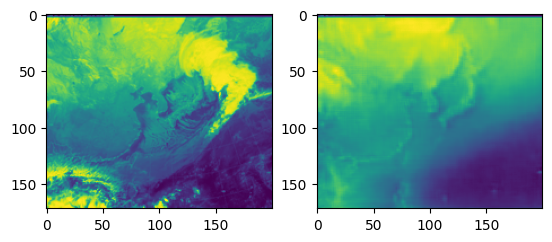

90it [00:06, 13.15it/s]


epoch: 21, step: 89, cost: 1529.625


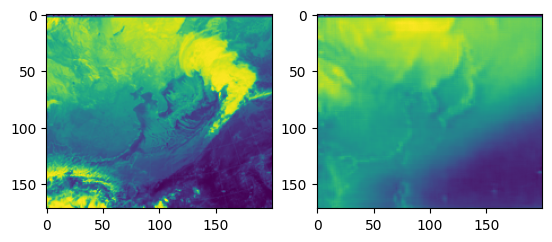

90it [00:06, 13.20it/s]


epoch: 22, step: 89, cost: 1422.38623046875


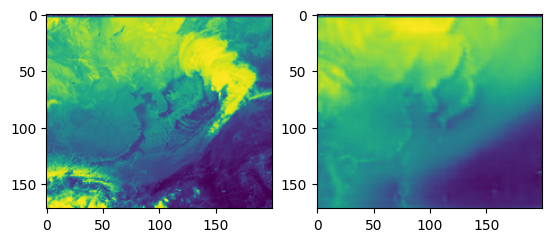

90it [00:06, 13.26it/s]


epoch: 23, step: 89, cost: 1484.32275390625


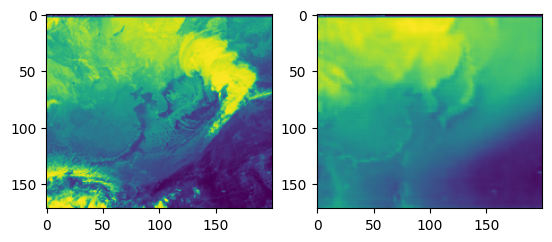

90it [00:06, 13.06it/s]


epoch: 24, step: 89, cost: 1481.652099609375


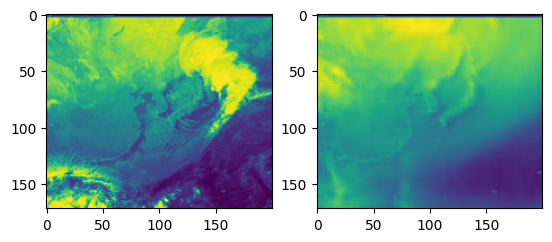

90it [00:06, 12.94it/s]


epoch: 25, step: 89, cost: 1499.9307861328125


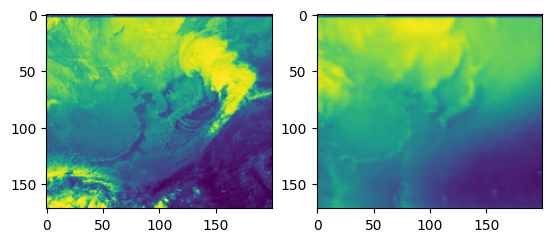

90it [00:06, 13.01it/s]


epoch: 26, step: 89, cost: 1402.6566162109375


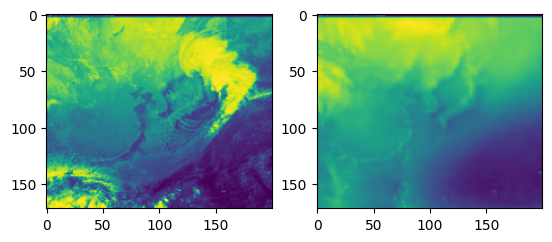

90it [00:06, 13.40it/s]


epoch: 27, step: 89, cost: 1412.178466796875


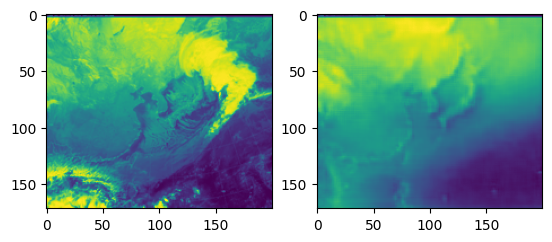

90it [00:06, 13.34it/s]


epoch: 28, step: 89, cost: 1507.614013671875


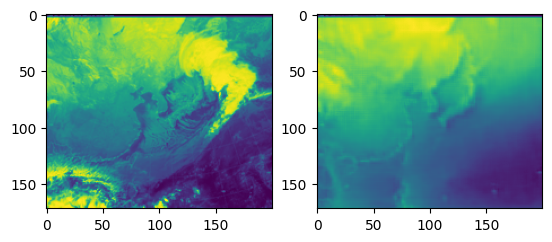

90it [00:06, 13.39it/s]


epoch: 29, step: 89, cost: 1524.49560546875


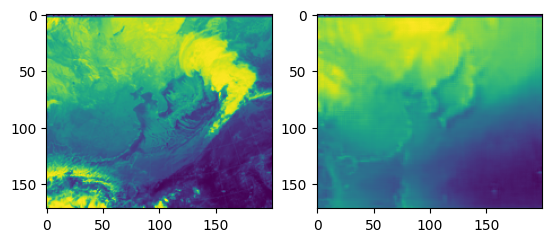

90it [00:06, 13.37it/s]


epoch: 30, step: 89, cost: 1529.0224609375


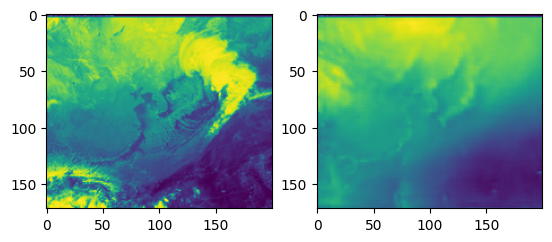

90it [00:06, 13.37it/s]


epoch: 31, step: 89, cost: 1558.81591796875


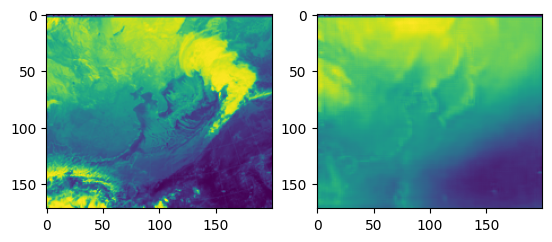

90it [00:06, 13.37it/s]


epoch: 32, step: 89, cost: 1649.35693359375


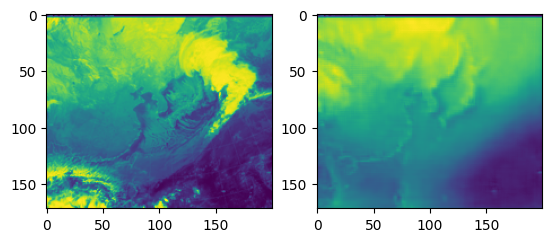

90it [00:06, 13.35it/s]


epoch: 33, step: 89, cost: 1693.3548583984375


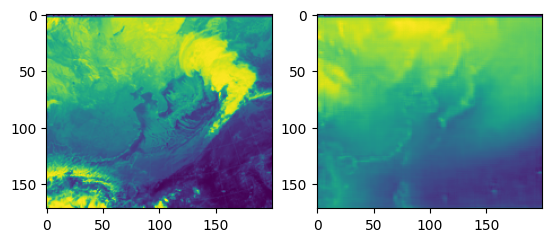

90it [00:06, 13.20it/s]


epoch: 34, step: 89, cost: 1506.287841796875


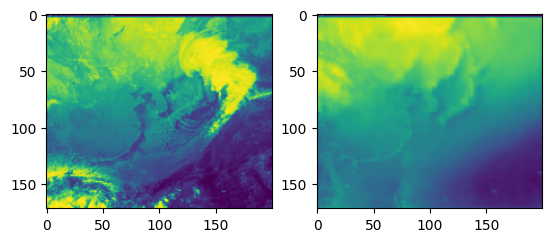

90it [00:06, 13.86it/s]


epoch: 35, step: 89, cost: 1528.324462890625


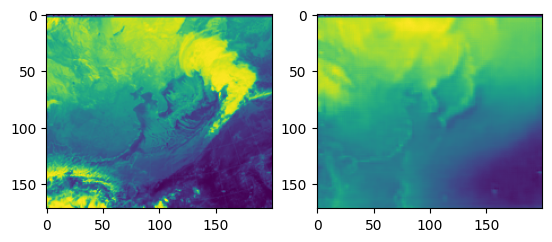

90it [00:06, 13.86it/s]


epoch: 36, step: 89, cost: 1471.4046630859375


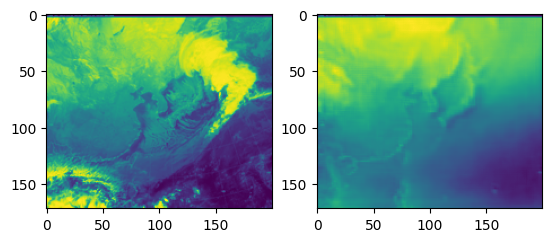

90it [00:06, 13.84it/s]


epoch: 37, step: 89, cost: 1507.015380859375


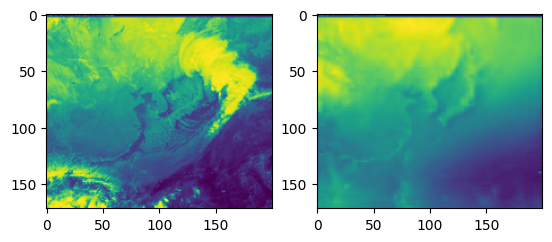

90it [00:06, 13.86it/s]


epoch: 38, step: 89, cost: 1482.633544921875


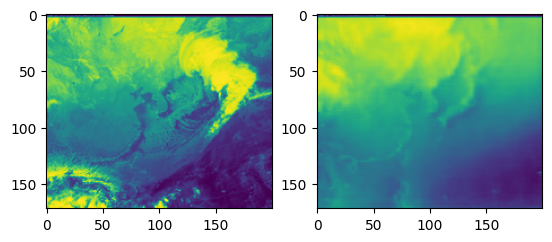

90it [00:06, 13.81it/s]


epoch: 39, step: 89, cost: 1922.1263427734375


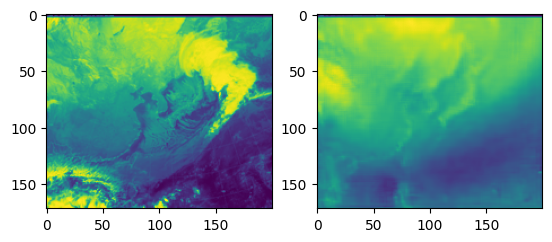

90it [00:06, 13.83it/s]


epoch: 40, step: 89, cost: 2079.47412109375


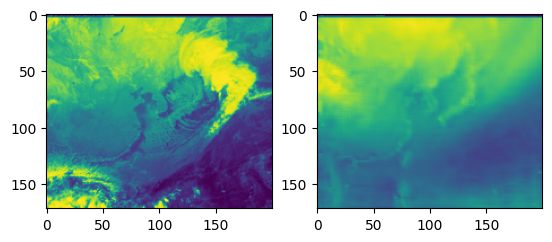

90it [00:06, 13.84it/s]


epoch: 41, step: 89, cost: 2036.60888671875


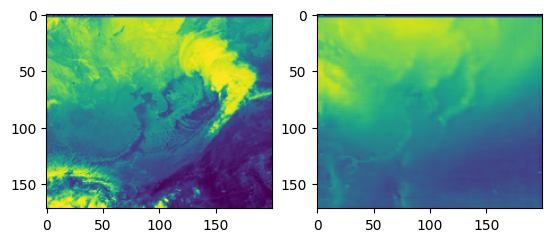

90it [00:06, 13.85it/s]


epoch: 42, step: 89, cost: 1934.5506591796875


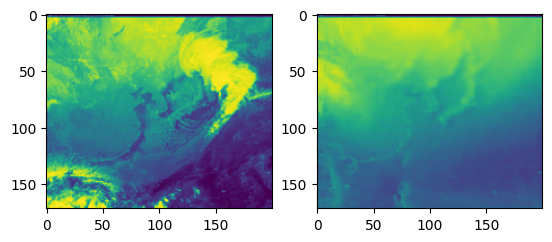

90it [00:06, 13.87it/s]


epoch: 43, step: 89, cost: 1967.894775390625


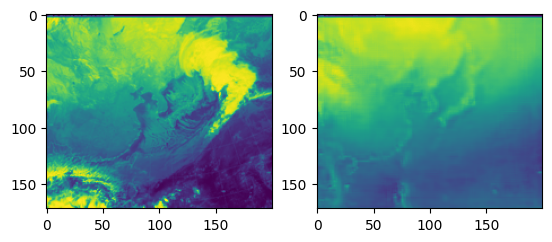

90it [00:06, 13.85it/s]


epoch: 44, step: 89, cost: 1886.2193603515625


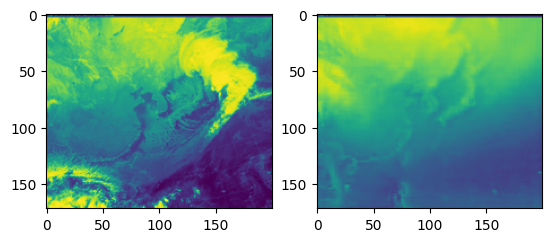

90it [00:06, 13.85it/s]


epoch: 45, step: 89, cost: 1861.5997314453125


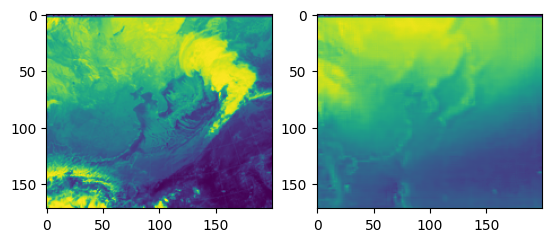

90it [00:06, 13.86it/s]


epoch: 46, step: 89, cost: 1852.1910400390625


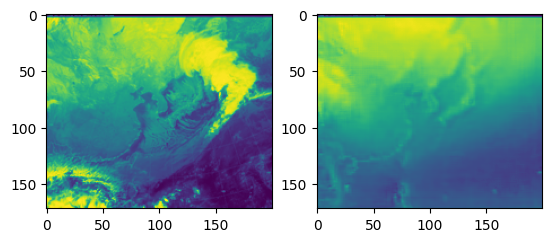

90it [00:06, 13.85it/s]


epoch: 47, step: 89, cost: 1840.8106689453125


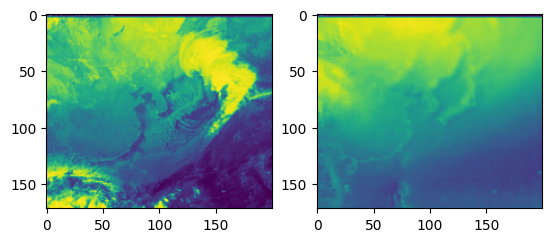

90it [00:06, 13.85it/s]


epoch: 48, step: 89, cost: 1835.0155029296875


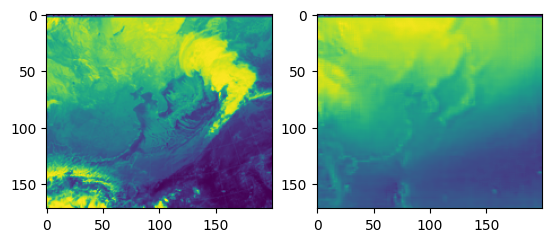

90it [00:06, 13.87it/s]


epoch: 49, step: 89, cost: 1830.035400390625


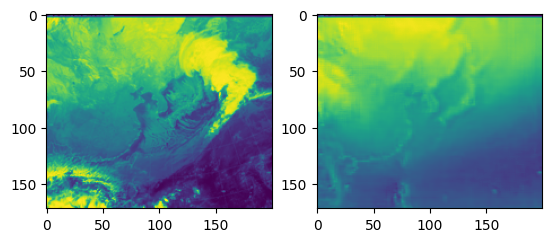

In [75]:
from tqdm import tqdm
from itertools import chain

loss_list = []
optim = torch.optim.Adam(model_winter.parameters(), lr=0.001)
mse = nn.MSELoss()

for epoch in range(50):
    for step, (date, img, feature, today, n, two) in tqdm(enumerate(coms_loader_train_winter)):
        
        x = img.to(DEVICE)
        feature = feature.to(torch.float32).to(DEVICE)
        t_pred, nex_pred, output = model_winter(x, feature)
        
        n = n.to(torch.float32).to(DEVICE)
        two = two.to(torch.float32).to(DEVICE)
        
        cost = mse(x, output)
        regression_loss1 = mse(t_pred, n)
        regression_loss2 = mse(nex_pred, two)
        
        total_loss = cost + regression_loss1 + regression_loss2
        
        optim.zero_grad()
        total_loss.backward()
        optim.step()
        loss_list.append(total_loss)
        
    with torch.no_grad():
        print(f"epoch: {epoch}, step: {step}, cost: {cost.item()}")
        plt.subplot(1, 2, 1)
        plt.imshow(x[0][0].cpu())
        plt.subplot(1, 2, 2)
        plt.imshow(output[0][0].cpu())
        plt.show()
        

In [74]:
from sklearn.metrics import f1_score, precision_score, recall_score

# 모델을 평가 모드로 설정
model_winter.eval()

# 예측과 레이블을 저장할 리스트 초기화
all_predictions = []
all_labels = []

# 테스트 데이터 로더를 통한 반복
with torch.no_grad():
    for step, (date, img, feature, today, n, two) in tqdm(enumerate(coms_loader_test_winter)):
        x = img.to(DEVICE)
        feature = feature.to(torch.float32).to(DEVICE)
        today = today.to(torch.float32).to(DEVICE)
        n = n.to(torch.float32).to(DEVICE)
        two = two.to(torch.float32).to(DEVICE)

        # 모델 예측
        t_pred, nex_pred, output = model_winter(x, feature)

        # 조건에 따라 이진 레이블 생성
        binary_label_t = ((n < -15) & (two < -15)) | ((today - n > 15) & (n < 3))
        binary_label = binary_label_t.float()
        

        # 임계값을 기준으로 예측 레이블 생성
        predicted =  ((t_pred < -12) & (nex_pred < -12)) | ((today - t_pred > 10) & (t_pred < 3)) # 예측 임계값 조정 필요

        # 예측과 레이블을 리스트에 추가
        all_predictions.extend(predicted.cpu().numpy())
        all_labels.extend(binary_label.cpu().numpy())

# 정밀도와 재현율 계산
precision = precision_score(all_labels, all_predictions, average='macro')
recall = recall_score(all_labels, all_predictions, average='macro')

print(f'Precision: {precision}')
print(f'Recall: {recall}')
f1_macro_score = f1_score(all_labels, all_predictions, average='macro')
print(f'F1 Macro Score: {f1_macro_score}')

32it [00:00, 37.91it/s]

Precision: 0.03125
Recall: 0.020833333333333332
F1 Macro Score: 0.025



C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\seclab\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\metrics\_classification.py:1757: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", le

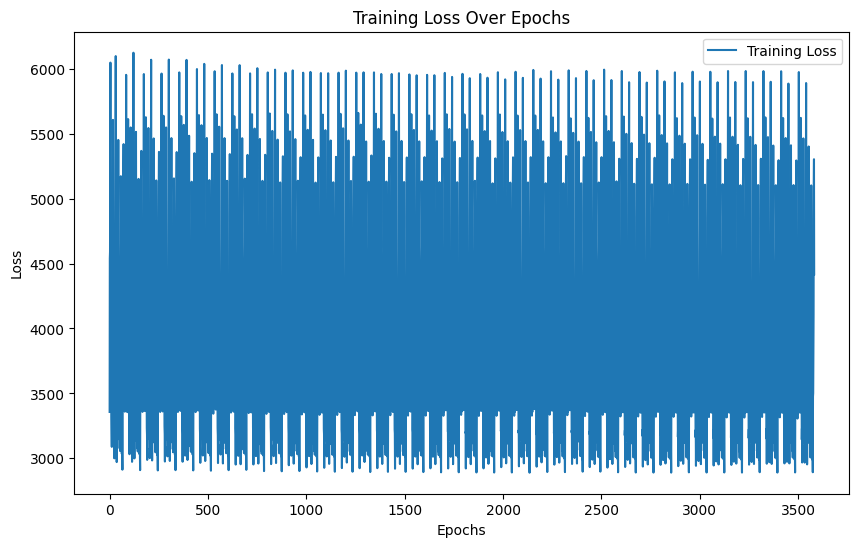

In [65]:
loss_array = [loss.cpu().detach().numpy() for loss in loss_list]

# 그래프 생성
plt.figure(figsize=(10, 6))
plt.plot(loss_array, label='Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Over Epochs')
plt.legend()
plt.show()

In [66]:
from collections import Counter

# all_predictions와 all_labels 리스트를 numpy 배열로 변환
all_predictions_np = np.array(all_predictions)
all_labels_np = np.array(all_labels)

total = [{"TP" : 0, "TN" : 0, "FP" : 0, "FN" : 0} for i in range(len(all_labels[0]))]

for idx1, i in enumerate(all_labels):
    pred = all_predictions[idx1]
    for idx2, data in enumerate(i):
        if data == 1:
            if data == pred[idx2]:
                total[idx2]['TP'] += 1
            else:
                total[idx2]['FN'] += 1
        
        else:
            if data == pred[idx2]:
                total[idx2]['TN'] += 1
            else:
                total[idx2]['FP'] += 1


total
# # 레이블의 0과 1의 수 계산
# label_counts = Counter(all_labels_np)
# print("레이블의 0과 1의 수:", label_counts)

# # 예측의 0과 1의 수 계산
# prediction_counts = Counter(all_predictions_np)
# print("예측의 0과 1의 수:", prediction_counts)

[{'TP': 18, 'TN': 469, 'FP': 20, 'FN': 1},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 3, 'TN': 497, 'FP': 6, 'FN': 2},
 {'TP': 2, 'TN': 505, 'FP': 1, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 0, 'TN': 505, 'FP': 3, 'FN': 0},
 {'TP': 3, 'TN': 503, 'FP': 2, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0},
 {'TP': 0, 'TN': 508, 'FP': 0, 'FN': 0}]

In [67]:
print("지역     TP      FP      FN       TN      F1")
for i in range(len(region)):
    print(region[i], "\t",total[i]['TP'], "\t", total[i]['FP'], "\t", total[i]['FN'], "\t", total[i]['TN'], "\t", calculate_f1_score(total[i]['TP'], total[i]['FN'], total[i]['FP'], total[i]['TN']))

지역     TP      FP      FN       TN      F1
춘천 	 18 	 20 	 1 	 469 	 0.63
강릉 	 0 	 0 	 0 	 508 	 0
서울 	 3 	 6 	 2 	 497 	 0.43
인천 	 2 	 1 	 0 	 505 	 0.8
울릉도 	 0 	 0 	 0 	 508 	 0
청주 	 0 	 3 	 0 	 505 	 0
대전 	 3 	 2 	 0 	 503 	 0.75
포항 	 0 	 0 	 0 	 508 	 0
대구 	 0 	 0 	 0 	 508 	 0
전주 	 0 	 0 	 0 	 508 	 0
울산 	 0 	 0 	 0 	 508 	 0
광주 	 0 	 0 	 0 	 508 	 0
부산 	 0 	 0 	 0 	 508 	 0
목포 	 0 	 0 	 0 	 508 	 0
여수 	 0 	 0 	 0 	 508 	 0
제주 	 0 	 0 	 0 	 508 	 0
